# Assignment 2 - Optical Flow

**Name**: Avneesh Mishra <br>
**Roll No**: 2021701032

In [55]:
# ---- Import everything ----
# Essentials
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
# Utilities
import os
# Helper functions
from helper_utils import read_flow, flow_to_image
# -- Developed functions --
# Harris Corner detector
from harris_corner import harris_corner_detector, \
    harris_corner_opencv
# Shi-Tomasi Corner detector
from shi_tomasi_corner import shi_tomasi_corner_detector, \
    shi_tomasi_corner_opencv
# Lukas-Kanade Optical Flow
from lukas_kanade import lukas_kanade_grid, lukas_kanade_dense, \
    optical_flow_cvdense, opt_flow_to_imgs
# Multi-scale lukas-kanade
from multiscale_lukas_kanade import opt_flow_refine_grid, \
    opt_flow_multiscale_grid


## Single Scale Lucas-Kanade Optical Flow

In [2]:
# Configurations
col_data_path = "./../data/all-frames-colour"

### Keypoint Selection

In [3]:
# Configurations
vno = 8     # Frame number

In [4]:
# Read files
col_data_path = os.path.realpath(os.path.expanduser(col_data_path))
# Grove3 image
img_grove3: np.ndarray = cv.imread(
    f"{col_data_path}/Grove3/frame{vno:02d}.png"
)
assert img_grove3 is not None, "File not found"
# RubberWhale image
img_rubberwhale: np.ndarray = cv.imread(
    f"{col_data_path}/RubberWhale/frame{vno:02d}.png"
)
assert img_rubberwhale is not None, "File not found"
# Urban2
img_urban2: np.ndarray = cv.imread(
    f"{col_data_path}/Urban2/frame{vno:02d}.png"
)
assert img_urban2 is not None, "File not found"
# All images
imgs = [img_grove3.copy(), img_rubberwhale.copy(), img_urban2.copy()]

#### Harris Corner Detector

**Paper**: [A combined corner and edge detector](http://www.bmva.org/bmvc/1988/avc-88-023.pdf)

```
Harris, Chris, and Mike Stephens. "A combined corner and edge detector." Alvey vision conference. Vol. 15. No. 50. 1988.
```

Using the detector created from ground-up

In [5]:
pts = []    # Points
for img in imgs:
    pts.append(harris_corner_detector(cv.cvtColor(img, 
        cv.COLOR_BGR2GRAY)))

In [6]:
# Draw points [x, y] as circles on image
def drawPoints(img, pts, color=(0, 0, 255), mksize=3):
    if len(img.shape) == 3: # BGR
        img_c = img.copy()
    else:   # Grayscale
        img_c = cv.cvtColor(img.copy(), cv.COLOR_GRAY2BGR)
    for px, py in pts:
        cv.circle(img_c, (px, py), mksize, color, cv.FILLED)
    return img_c

In [7]:
m_imgs_ud = [   # Marked images (user defined)
    drawPoints(imgs[i], pts[i], (0, 255, 0)) for i in range(3)
]

Using the detector created using OpenCV

In [8]:
pts = []    # Points
for img in imgs:
    pts.append(harris_corner_opencv(cv.cvtColor(img, 
        cv.COLOR_BGR2GRAY)))

In [9]:
m_imgs_cv = [   # Marked images (through OpenCV)
    drawPoints(imgs[i], pts[i], (0, 255, 0)) for i in range(3)
]

Comparison

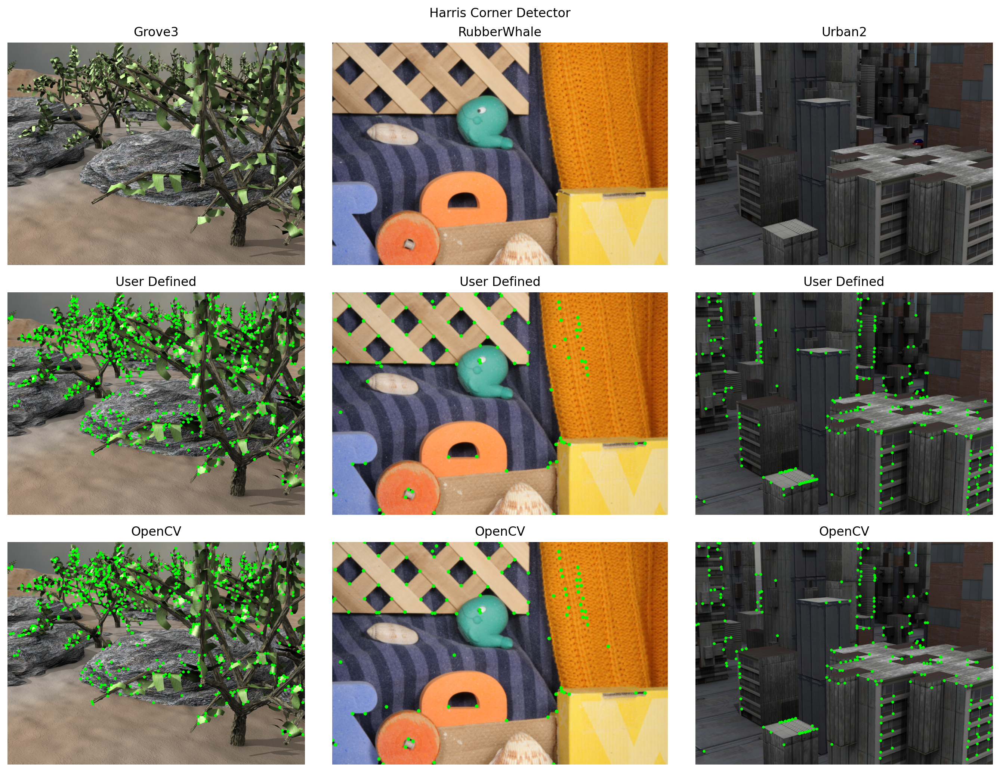

In [10]:
# ------ Main plot ------
fig = plt.figure(figsize=(14, 10.5), dpi=200)
gs = fig.add_gridspec(3, 3)
# Main images on first row
ax = fig.add_subplot(gs[0, 0])
ax.imshow(img_grove3[..., ::-1])
ax.set_axis_off()
ax.set_title("Grove3")
ax = fig.add_subplot(gs[0, 1])
ax.imshow(img_rubberwhale[..., ::-1])
ax.set_axis_off()
ax.set_title("RubberWhale")
ax = fig.add_subplot(gs[0, 2])
ax.imshow(img_urban2[..., ::-1])
ax.set_axis_off()
ax.set_title("Urban2")
# Ground-up
ax = fig.add_subplot(gs[1, 0])
ax.imshow(m_imgs_ud[0][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
ax = fig.add_subplot(gs[1, 1])
ax.imshow(m_imgs_ud[1][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
ax = fig.add_subplot(gs[1, 2])
ax.imshow(m_imgs_ud[2][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
# OpenCV
ax = fig.add_subplot(gs[2, 0])
ax.imshow(m_imgs_cv[0][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[2, 1])
ax.imshow(m_imgs_cv[1][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[2, 2])
ax.imshow(m_imgs_cv[2][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
fig.suptitle("Harris Corner Detector")
fig.set_tight_layout(True)

These seem similar (not a bad deviation)

#### Shi-Tomasi Corner Detector

**Paper**: [Good features to track](http://www.ai.mit.edu/courses/6.891/handouts/shi94good.pdf)

```
Shi, Jianbo. "Good features to track." 1994 Proceedings of IEEE conference on computer vision and pattern recognition. IEEE, 1994.
```

Using the detector created from ground-up

In [11]:
pts = []    # Points
for img in imgs:
    pts.append(shi_tomasi_corner_detector(cv.cvtColor(img, 
        cv.COLOR_BGR2GRAY)))

In [12]:
m_imgs_ud = [   # Marked images (user defined)
    drawPoints(imgs[i], pts[i], (0, 255, 0)) for i in range(3)
]

Using the detector created using OpenCV

In [13]:
pts = []    # Points
for img in imgs:
    points = cv.goodFeaturesToTrack(cv.cvtColor(img, 
        cv.COLOR_BGR2GRAY), 200, 0.02, 5)
    pts.append(points.squeeze().astype(np.int64))

In [14]:
m_imgs_cv = [   # Marked images (through OpenCV)
    drawPoints(imgs[i], pts[i], (0, 255, 0)) for i in range(3)
]

Comparison

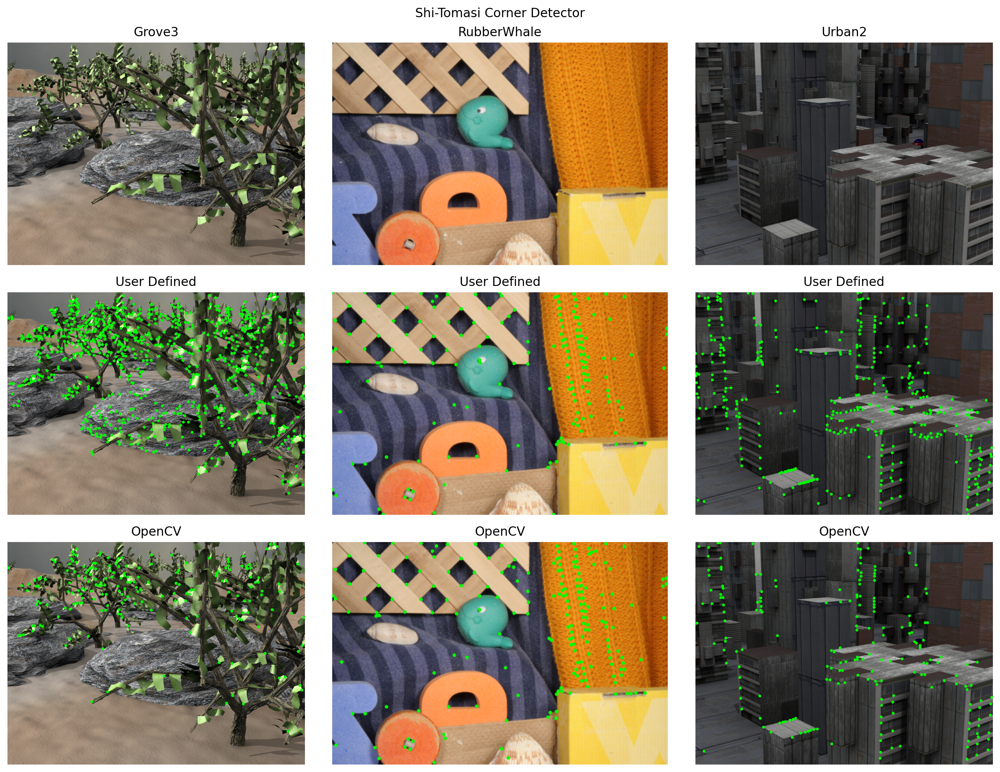

In [15]:
# ------ Main plot ------
fig = plt.figure(figsize=(14, 10.5), dpi=200)
gs = fig.add_gridspec(3, 3)
# Main images on first row
ax = fig.add_subplot(gs[0, 0])
ax.imshow(img_grove3[..., ::-1])
ax.set_axis_off()
ax.set_title("Grove3")
ax = fig.add_subplot(gs[0, 1])
ax.imshow(img_rubberwhale[..., ::-1])
ax.set_axis_off()
ax.set_title("RubberWhale")
ax = fig.add_subplot(gs[0, 2])
ax.imshow(img_urban2[..., ::-1])
ax.set_axis_off()
ax.set_title("Urban2")
# Ground-up
ax = fig.add_subplot(gs[1, 0])
ax.imshow(m_imgs_ud[0][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
ax = fig.add_subplot(gs[1, 1])
ax.imshow(m_imgs_ud[1][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
ax = fig.add_subplot(gs[1, 2])
ax.imshow(m_imgs_ud[2][..., ::-1])
ax.set_axis_off()
ax.set_title("User Defined")
# OpenCV
ax = fig.add_subplot(gs[2, 0])
ax.imshow(m_imgs_cv[0][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[2, 1])
ax.imshow(m_imgs_cv[1][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[2, 2])
ax.imshow(m_imgs_cv[2][..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
fig.suptitle("Shi-Tomasi Corner Detector")
fig.set_tight_layout(True)

These seem similar (not a bad deviation). We might want to use a different threshold for the user defined method.


In [16]:
# A cell for rough work

### Forward-Additive Sparse Optical Flow

Lukas-Kanade algorithm explored in different forms

**Paper**: An iterative image registration technique with an application to stereo vision

```
Lucas, Bruce D., and Takeo Kanade. "An iterative image registration technique with an application to stereo vision." 1981.
```

#### Demo

Showing how to compute optical flow (quickly) through the grid method. This is not dense (not for every pixel).

In [17]:
# Read images
img1 = cv.imread("./../data/test/img1.jpg")
img2 = cv.imread("./../data/test/img2.jpg")

In [18]:
# Grid optical flow
positions_np, optical_flow_np, tvs = lukas_kanade_grid(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY), 
    win_h = 25, win_w = 25, ev_thresh = 0.05)

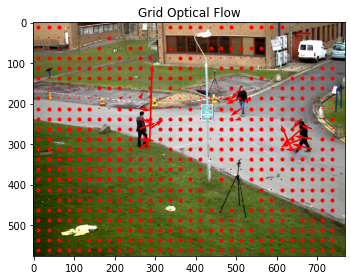

In [19]:
# Show image
plt.title("Grid Optical Flow")
plt.imshow(img1[..., ::-1])
for pos, h, tv in zip(positions_np, optical_flow_np, tvs):
    # print(f"{tv}")
    if np.allclose(h, np.zeros_like(h)):
        plt.plot(pos[1], pos[0], 'r.')
    else:
        plt.quiver(pos[1], pos[0], h[0], h[1], color='red', 
            width=5e-3, scale=3)
plt.tight_layout()
plt.show()


#### Comparison with OpenCV

Let's compare our method with the OpenCV method for finding dense correspondences.

OpenCV uses the Gunnar Farneback's algorithm

**Paper**: [Two-frame motion estimation based on polynomial expansion](https://link.springer.com/content/pdf/10.1007/3-540-45103-X_50.pdf)

```
Farnebäck, Gunnar. "Two-frame motion estimation based on polynomial expansion." Scandinavian conference on Image analysis. Springer, Berlin, Heidelberg, 2003.
```

In [20]:
# Using our method from ground-up
opt_flow_real, th_img = lukas_kanade_dense(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY))

In [21]:
# HSV image to display
opt_flow = opt_flow_real * 25   # A scaling factor we're applying
hsv_img, bgr_img = opt_flow_to_imgs(opt_flow)

In [22]:
# Using OpenCV
opt_flow_cv = optical_flow_cvdense(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY))
hsv_cv, bgr_cv = opt_flow_to_imgs(opt_flow_cv, 0.0)

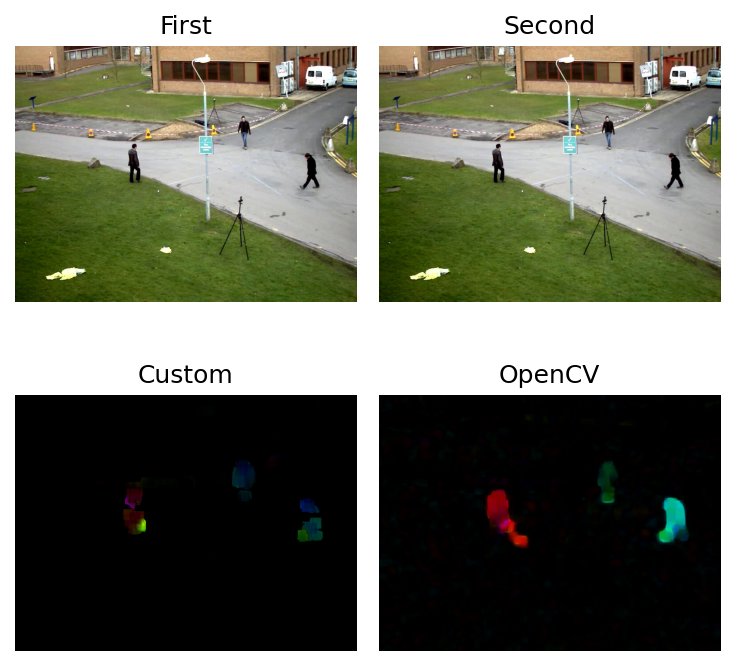

In [23]:
# Compare both
plt.figure(figsize=(5, 5), dpi=150)
plt.subplot(2, 2, 1)
plt.title("First")
plt.imshow(img1[..., ::-1])
plt.axis('off')
plt.subplot(2, 2, 2)
plt.title("Second")
plt.imshow(img1[..., ::-1])
plt.axis('off')
plt.subplot(2, 2, 3)
plt.title("Custom")
plt.imshow(bgr_img[..., ::-1])
plt.axis('off')
plt.subplot(2, 2, 4)
plt.title("OpenCV")
plt.imshow(bgr_cv[..., ::-1])
plt.axis('off')
plt.tight_layout()
plt.show()

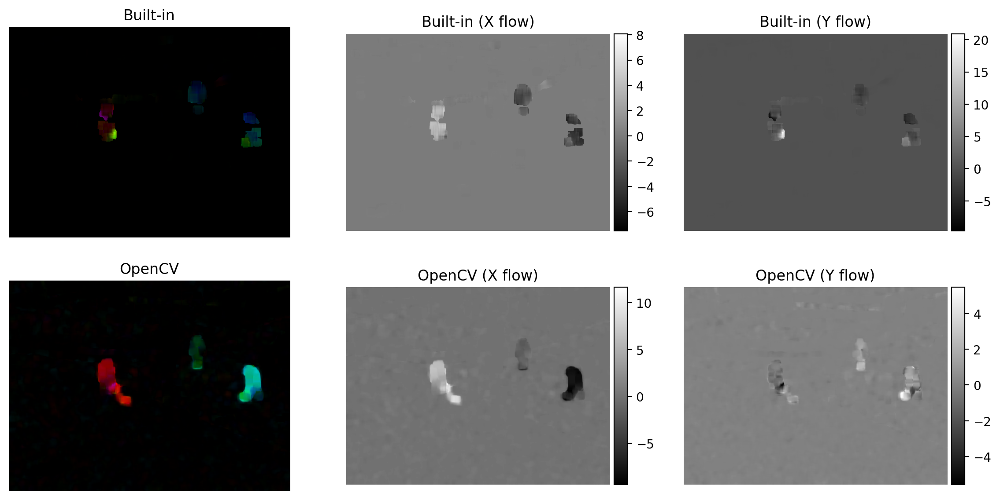

In [24]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
# Another comparison
fig = plt.figure(figsize=(14, 7), dpi=200)
gs = fig.add_gridspec(2, 3)
# Built-in result
ax = fig.add_subplot(gs[0, 0])
ax.imshow(bgr_img[..., ::-1])
ax.set_axis_off()
ax.set_title("Built-in")
ax = fig.add_subplot(gs[0, 1])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow[..., 0], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("Built-in (X flow)")
ax = fig.add_subplot(gs[0, 2])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow[..., 1], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("Built-in (Y flow)")
# OpenCV result
ax = fig.add_subplot(gs[1, 0])
ax.imshow(bgr_cv[..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[1, 1])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow_cv[..., 0], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("OpenCV (X flow)")
ax = fig.add_subplot(gs[1, 2])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow_cv[..., 1], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("OpenCV (Y flow)")
plt.show(fig)

This is nearly similar, given that our method doesn't apply any pyramid. The OpenCV method is faster and yields better results (it is more optimized).

#### Average End Point Error

The notion of end-point error is derived from the _error_ in flow _endpoint_ (from section 4.1 of [Middlebury flow dataset](https://vision.middlebury.edu/flow/) paper).

**Paper**: A Database and Evaluation Methodology for Optical Flow

```
Baker, Simon, et al. "A database and evaluation methodology for optical flow." International journal of computer vision 92.1 (2011): 1-31.
```


##### Here's what we will do

1. Read images and obtain corners from the first image. We want to know where these corners went in the next image.
2. Obtain the ground truth from the `.flo` file. The ground truth of the new marker positions in the second image is obtained through this file.
3. Obtain the optical flow through our implementation (and OpenCV).
4. Calculate the end point error using the following equation (from the paper)

    $$
    \textup{AEE} = \frac{1}{N} \sum_{i=1}^{N} \sqrt{(u_i - u_{\textup{GT}_i})^2 + (v_i - v_{\textup{GT}_i})^2}
    $$

    Where $(u_i, v_i)$ is the computed optical flow of the $i$-th feature. The $(u_{\textup{GT}_i}, v_{\textup{GT}_i})$ is the ground truth optical flow (read from the file). There are $N$ features detected.

    This is the extension of the $\textup{EE}$ (Endpoint Error) for individual interest points.

The same can be tried through different flow calculation algorithms (our custom made and the OpenCV's one).


##### Step 1: Read images

In [25]:
# Read the image
dataset_seg = "RubberWhale" # Dataset segment
num1, num2 = 10, 11     # Frame numbers

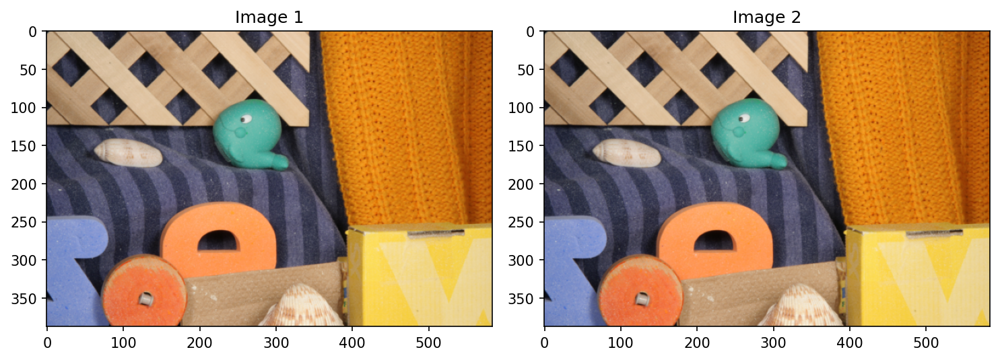

In [26]:
# Paths
img1_path = f"./../data/all-frames-colour/{dataset_seg}/"\
            f"frame{num1:02d}.png"
img2_path = f"./../data/all-frames-colour/{dataset_seg}/"\
            f"frame{num2:02d}.png"
# BGR images
img1 = cv.imread(img1_path)
img2 = cv.imread(img2_path)
# Show images
plt.figure(figsize=(10, 5), dpi=150)
plt.subplot(1,2,1)
plt.title("Image 1")
plt.imshow(img1[..., ::-1])
plt.subplot(1,2,2)
plt.title("Image 2")
plt.imshow(img2[..., ::-1])
plt.tight_layout()
plt.show()

Next: Detect Corners

In [27]:
# Main corners for the images
img1_corners_harris = harris_corner_detector(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY))
img1_corners_st = shi_tomasi_corner_detector(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY))
# Just to display (not being used)
img2_corners_harris = harris_corner_detector(
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY))
img2_corners_st = shi_tomasi_corner_detector(
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY))

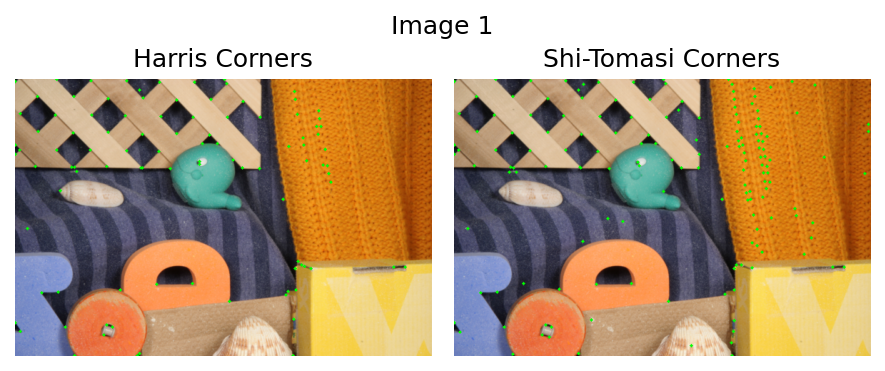

In [28]:
# Show images
i1_h = drawPoints(img1, img1_corners_harris, (0, 255, 0), 2)
i1_st = drawPoints(img1, img1_corners_st, (0, 255, 0), 2)
# Plot on the image
plt.figure(figsize=(6, 2.5), dpi=150)
plt.suptitle("Image 1")
plt.subplot(1, 2, 1)
plt.title("Harris Corners")
plt.imshow(i1_h[..., ::-1])
plt.axis('off')
plt.subplot(1, 2, 2)
plt.title("Shi-Tomasi Corners")
plt.imshow(i1_st[..., ::-1])
plt.axis('off')
plt.tight_layout()
plt.show()

Shi-Tomasi got more corners

In [29]:
# Some space for rough work!

##### Step 2: Reading `.flo` files

Reading optical flow files through the helper functions given

In [30]:
# Maximum threshold
max_thresh = 2e8
# Read original flow
flow_path = f"./../data/ground-truth-flow/{dataset_seg}/" \
            f"flow{num1}.flo"
flow_original = read_flow(flow_path)
# Filter it
flow = flow_original.copy()
flow[flow > max_thresh] = 0

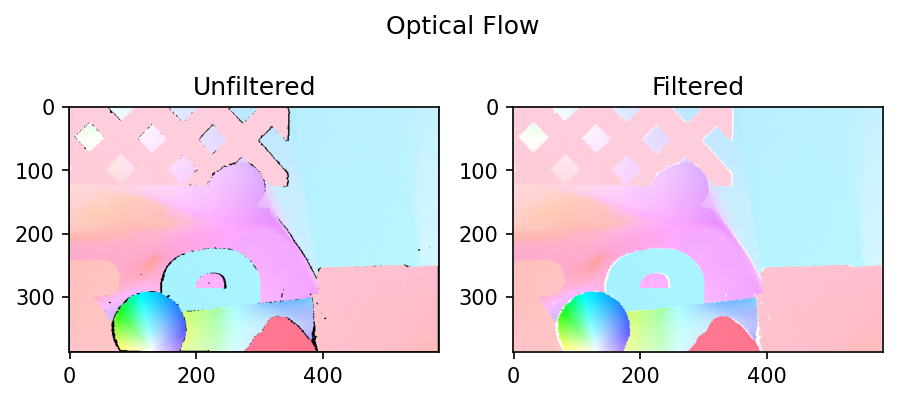

In [31]:
# Show flow
img_original = flow_to_image(flow_original.copy())
img = flow_to_image(flow.copy())
# Show flows
plt.figure(figsize=(7, 3), dpi=150)
plt.suptitle("Optical Flow")
plt.subplot(1,2,1)
plt.title("Unfiltered")
plt.imshow(img_original)
plt.subplot(1,2,2)
plt.title("Filtered")
plt.imshow(img)
plt.show()

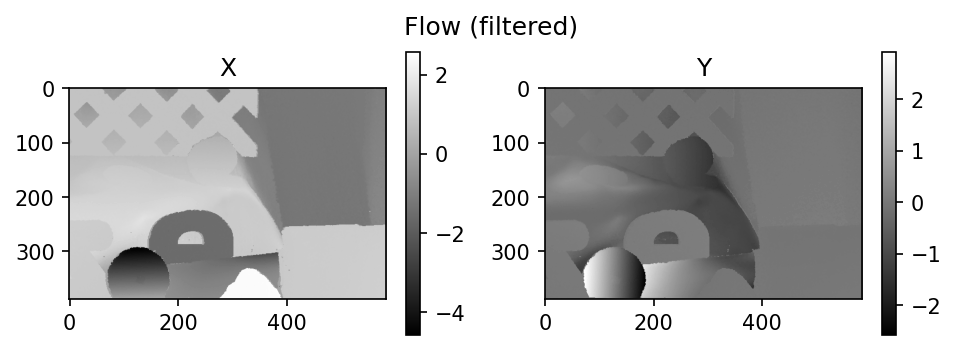

In [32]:
# Show the filtered X and Y
plt.figure(figsize=(7.5, 2.5), dpi=150)
plt.suptitle("Flow (filtered)")
plt.subplot(1,2,1)
plt.title("X")
plt.imshow(flow[..., 0], 'gray')
plt.colorbar()
plt.subplot(1,2,2)
plt.title("Y")
plt.imshow(flow[..., 1], 'gray')
plt.colorbar()
plt.show()

Next: Ground truth for Optical Flow

In [33]:
flow_gt_init = img1_corners_harris.copy().astype(float)
flow_gt_final = np.zeros_like(flow_gt_init, float)
flow_u = flow      # Can use `flow` for filtered

In [34]:
# Get the final optical flow (for points)
for i, (px, py) in enumerate(flow_gt_init.copy().astype(int)):
    dx, dy = flow_u[py][px]
    flow_gt_final[i, 0] = flow_gt_init[i, 0] + dx
    flow_gt_final[i, 1] = flow_gt_init[i, 1] + dy

Ground truth optical flow $(u, v)$

In [35]:
# flow_* has the pixel, get uv
uv_gt = flow_gt_final - flow_gt_init

In [36]:
# Some space for rough work!

##### Step 3: Optical Flow

In [37]:
# Grid optical flow
positions_np, optical_flow_np, tvs = lukas_kanade_grid(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY), 
    win_h = 25, win_w = 25, ev_thresh = 0.05)

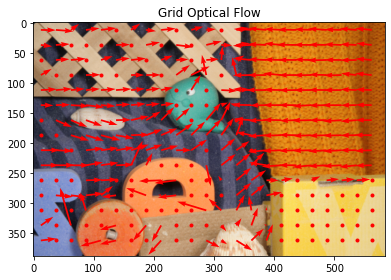

In [38]:
# Show image
plt.title("Grid Optical Flow")
plt.imshow(img1[..., ::-1])
for pos, h, tv in zip(positions_np, optical_flow_np, tvs):
    # print(f"{tv}")
    if np.allclose(h, np.zeros_like(h)):
        plt.plot(pos[1], pos[0], 'r.')
    else:
        plt.quiver(pos[1], pos[0], h[0], h[1], color='red', 
            width=5e-3, scale=3)
plt.tight_layout()
plt.show()


The function `lukas_kanade_dense` is the function `LukasKanadeForwardAdditive` desired by the question. The `windowSize` is 15 here and the threshold $\tau$ is `ev_thresh` (they could be different).

In [39]:
# Using our method from ground-up
opt_flow_real, th_img = lukas_kanade_dense(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY), 15, ev_thresh=0.001)
# HSV image to display
opt_flow = opt_flow_real * 15   # Scaling factor
hsv_img, bgr_img = opt_flow_to_imgs(opt_flow)

In [40]:
# Using OpenCV
opt_flow_cv = optical_flow_cvdense(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY))
hsv_cv, bgr_cv = opt_flow_to_imgs(opt_flow_cv, 0.0)

Comparing the outputs of built-in and opencv

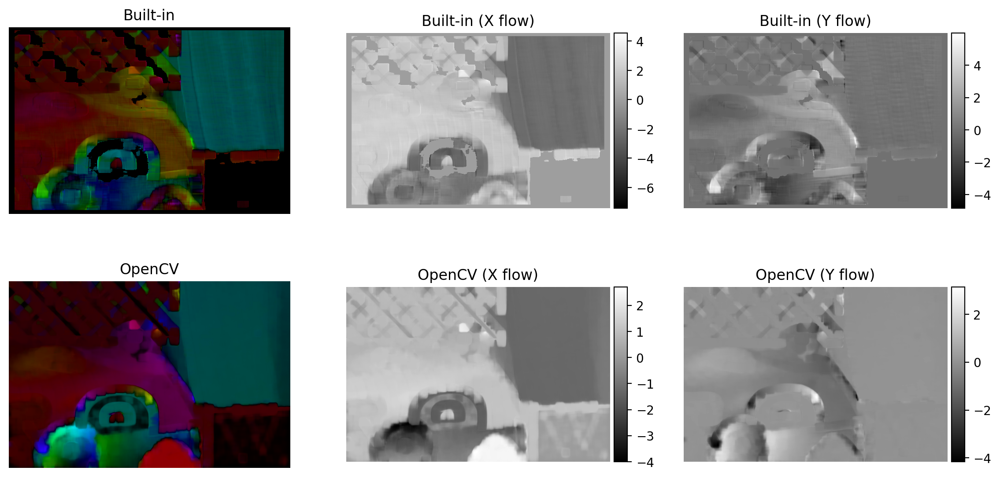

In [41]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
# Another comparison
fig = plt.figure(figsize=(14, 7), dpi=200)
gs = fig.add_gridspec(2, 3)
# Built-in result
ax = fig.add_subplot(gs[0, 0])
ax.imshow(bgr_img[..., ::-1])
ax.set_axis_off()
ax.set_title("Built-in")
ax = fig.add_subplot(gs[0, 1])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow[..., 0], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("Built-in (X flow)")
ax = fig.add_subplot(gs[0, 2])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow[..., 1], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("Built-in (Y flow)")
# OpenCV result
ax = fig.add_subplot(gs[1, 0])
ax.imshow(bgr_cv[..., ::-1])
ax.set_axis_off()
ax.set_title("OpenCV")
ax = fig.add_subplot(gs[1, 1])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow_cv[..., 0], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("OpenCV (X flow)")
ax = fig.add_subplot(gs[1, 2])
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)
im = ax.imshow(opt_flow_cv[..., 1], 'gray')
fig.colorbar(im, cax=cax, orientation='vertical')
ax.set_axis_off()
ax.set_title("OpenCV (Y flow)")
plt.show(fig)

Get the calculated values for optical flow

In [42]:
uv_cv = np.zeros_like(uv_gt)
uv_lk = np.zeros_like(uv_gt)

In [43]:
for i, (px, py) in enumerate(flow_gt_init.copy().astype(int)):
    uv_lk[i, 0] = opt_flow[py, px, 0]
    uv_lk[i, 1] = opt_flow[py, px, 1]
    # OpenCV optical flow
    uv_cv[i, 0] = opt_flow_cv[py, px, 0]
    uv_cv[i, 1] = opt_flow_cv[py, px, 1]

##### Step 4: Average Endpoint Error

In [44]:
aee_cv_hc = np.mean(np.linalg.norm(uv_cv - uv_gt, axis=1))
aee_lk_hc = np.mean(np.linalg.norm(uv_lk - uv_gt, axis=1))
print(f"For Harris Corner detector")
print(f"\tOpenCV: {aee_cv_hc}")
print(f"\tUser built: {aee_lk_hc}")

For Harris Corner detector
	OpenCV: 0.3412429692521774
	User built: 1.1631194609267097


Using Shi-Tomasi detector

In [45]:
flow_gt_init = img1_corners_st.copy().astype(float)
# Ground truth
uv_gt = np.zeros_like(flow_gt_init)
for i, (px, py) in enumerate(flow_gt_init.copy().astype(int)):
    uv_gt[i, 0] = flow_u[py, px, 0]
    uv_gt[i, 1] = flow_u[py, px, 1]
# OpenCV and Built-in
uv_cv = np.zeros_like(uv_gt)
uv_lk = np.zeros_like(uv_gt)
for i, (px, py) in enumerate(flow_gt_init.copy().astype(int)):
    uv_lk[i, 0] = opt_flow[py, px, 0]
    uv_lk[i, 1] = opt_flow[py, px, 1]
    # OpenCV optical flow
    uv_cv[i, 0] = opt_flow_cv[py, px, 0]
    uv_cv[i, 1] = opt_flow_cv[py, px, 1]

In [46]:
aee_cv_st = np.mean(np.linalg.norm(uv_cv - uv_gt, axis=1))
aee_lk_st = np.mean(np.linalg.norm(uv_lk - uv_gt, axis=1))
print(f"For Shi-Tomasi detector")
print(f"\tOpenCV: {aee_cv_st}")
print(f"\tUser built: {aee_lk_st}")

For Shi-Tomasi detector
	OpenCV: 0.252714136510693
	User built: 1.1934461698282957


##### Result

Summary of all AEE

In [47]:
print(f"For Harris Corner detector")
print(f"\tOpenCV: {aee_cv_hc}")
print(f"\tUser built: {aee_lk_hc}")
print(f"For Shi-Tomasi detector")
print(f"\tOpenCV: {aee_cv_st}")
print(f"\tUser built: {aee_lk_st}")

For Harris Corner detector
	OpenCV: 0.3412429692521774
	User built: 1.1631194609267097
For Shi-Tomasi detector
	OpenCV: 0.252714136510693
	User built: 1.1934461698282957


This is not very bad compared to many methods (specially old ones) in the [evaluation results](https://vision.middlebury.edu/flow/eval/results/results-e1.php).


### Analyzing Lucas-Kanade Method

The answers for the section 2.3 is included in `./docs/report.pdf` file (reports).

## Multi-scale Coarse-to-fine Optical Flow


In [49]:
# Read images
img1 = cv.imread(
    "./../data/all-frames-colour/RubberWhale/frame07.png")
img2 = cv.imread(
    "./../data/all-frames-colour/RubberWhale/frame08.png")
# Parameters
win_h, win_w = 15, 15
sf_val = 7
ev_thresh = 0.05

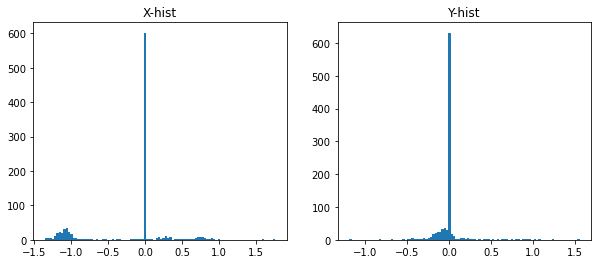

In [54]:
# Normal Lukas-Kanade method
positions_np, optical_flow_np, tvs = lukas_kanade_grid(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY), 
    win_h = win_h, win_w = win_w, ev_thresh = 0.05)
# Show results
plt.figure(figsize=(10, 4))
plt.subplot(1,2,1)
plt.title("X-hist")
_ = plt.hist(sf_val * optical_flow_np[:, 0], 100)
plt.subplot(1,2,2)
plt.title("Y-hist")
_ = plt.hist(sf_val * optical_flow_np[:, 1], 100)
plt.show()

In [57]:
noflow_np = opt_flow_refine_grid(img1, img2, win_h, win_w, 
    (positions_np, optical_flow_np), sf_val)
err = np.sum(np.linalg.norm(optical_flow_np - noflow_np, axis=1))
print(f"Deviation: {err}")

Deviation: 1.9314173839255044


This deviation is certainly acceptable (less than 2 pixels across the entire image)

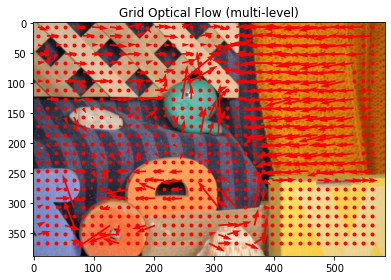

In [59]:
# Actual multi-level optical flow
out_coords, out_oflow = opt_flow_multiscale_grid(img1, img2, 3, 
    win_h, win_w, sf_val, ev_thresh)
plt.title("Grid Optical Flow (multi-level)")
plt.imshow(img1[..., ::-1])
for pos, h in zip(out_coords, out_oflow):
    if np.allclose(h, np.zeros_like(h)):
        plt.plot(pos[1], pos[0], 'r.')
    else:
        plt.quiver(pos[1], pos[0], h[0], h[1], color='red', 
            width=5e-3, scale=3)
plt.tight_layout()
plt.show()

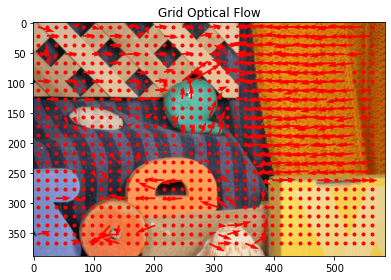

In [60]:
# Single scale LK method
positions_np, optical_flow_np, tvs = lukas_kanade_grid(
    cv.cvtColor(img1.copy(), cv.COLOR_BGR2GRAY), 
    cv.cvtColor(img2.copy(), cv.COLOR_BGR2GRAY), 
    win_h = win_h, win_w = win_w, ev_thresh = 0.05)
plt.title("Grid Optical Flow")
plt.imshow(img1[..., ::-1])
for pos, h, tv in zip(positions_np, optical_flow_np, tvs):
    # print(f"{tv}")
    if np.allclose(h, np.zeros_like(h)):
        plt.plot(pos[1], pos[0], 'r.')
    else:
        plt.quiver(pos[1], pos[0], h[0], h[1], color='red', 
            width=5e-3, scale=3)
plt.tight_layout()
plt.show()

In the images below, we see that the multi-scale model (on the left) can detect more optical flow vectors than the single scale model (on the right).

<img alt="multi-scale model" src="./figures/multi-scale.jpg" height="300"/>
<img alt="single-scale model" src="./figures/single-scale.jpg" height="300"/>
